# Exploratory Data Analisys
322548363, 211821111

In [1]:
import os
import pandas as pd
# get train data
files = os.listdir('data/train')
full_data = pd.concat([pd.read_csv(f'data/train/{file}',sep='|') for file in (files)])

In [2]:
sepsis_data = full_data[full_data['SepsisLabel'] == 1].reset_index(drop=True)
non_sepsis_data = full_data[full_data['SepsisLabel'] == 0].reset_index(drop=True)

### a. Which features are available in the dataset

In [3]:
full_data.columns

Index(['HR', 'O2Sat', 'Temp', 'SBP', 'MAP', 'DBP', 'Resp', 'EtCO2',
       'BaseExcess', 'HCO3', 'FiO2', 'pH', 'PaCO2', 'SaO2', 'AST', 'BUN',
       'Alkalinephos', 'Calcium', 'Chloride', 'Creatinine', 'Bilirubin_direct',
       'Glucose', 'Lactate', 'Magnesium', 'Phosphate', 'Potassium',
       'Bilirubin_total', 'TroponinI', 'Hct', 'Hgb', 'PTT', 'WBC',
       'Fibrinogen', 'Platelets', 'Age', 'Gender', 'Unit1', 'Unit2',
       'HospAdmTime', 'ICULOS', 'SepsisLabel'],
      dtype='object')

### b. 

basic info on feature distributions:

In [4]:
description = full_data.describe(include='all')
# missing data for each feature:
description.loc['not null(%)'] = round(description.loc['count'] / (full_data.shape[0])*100,2)
description = round(description,2)
description = description.T
description

,count,mean,std,min,25%,50%,75%,max,not null(%)
HR,690913.0,84.66,17.40,20.00,72.00,84.00,96.00,280.00,90.09
O2Sat,666682.0,97.19,2.95,20.00,96.00,98.00,99.50,100.00,86.93
Temp,260148.0,36.98,0.78,20.90,36.50,37.00,37.50,50.00,33.92
SBP,654052.0,123.52,23.16,20.00,106.50,121.00,138.00,299.00,85.29
MAP,671078.0,82.30,16.29,20.00,71.00,80.00,92.00,300.00,87.51
DBP,527697.0,63.79,13.90,20.00,54.00,62.00,72.00,300.00,68.81
Resp,648543.0,18.75,5.11,1.00,15.00,18.00,21.50,100.00,84.57
EtCO2,27441.0,33.03,7.99,10.00,28.00,33.00,38.00,100.00,3.58
BaseExcess,42076.0,-0.75,4.31,-32.00,-3.00,0.00,1.00,49.50,5.49
HCO3,31809.0,24.08,4.39,0.00,22.00,24.00,26.00,55.00,4.15


histograms for feature distributions for sepsis and non sepsis patients:

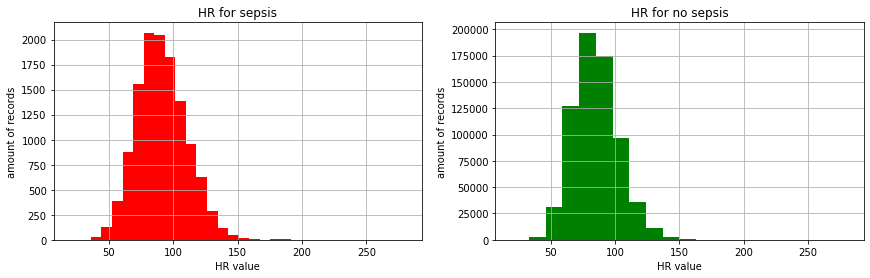

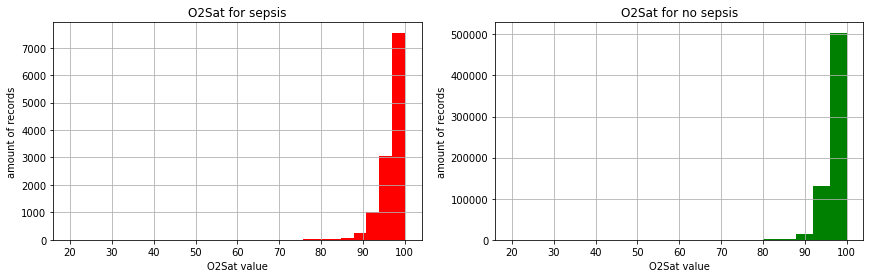

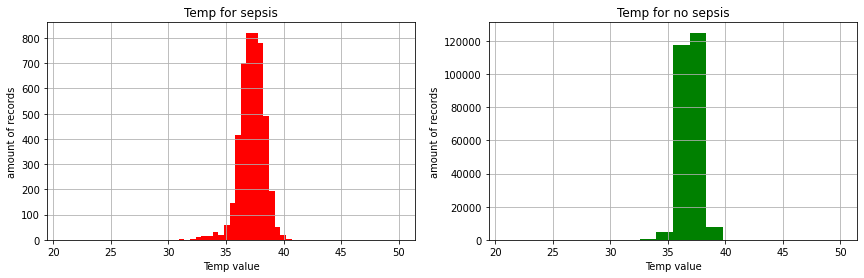

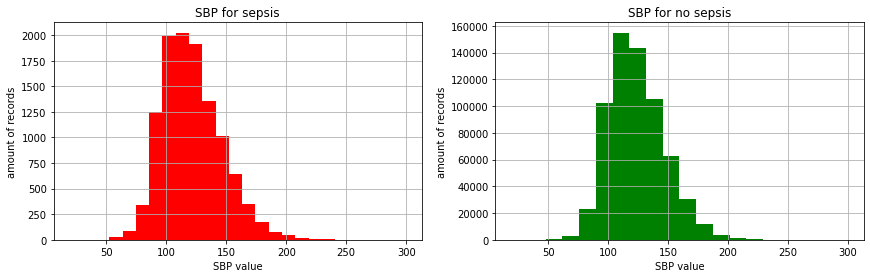

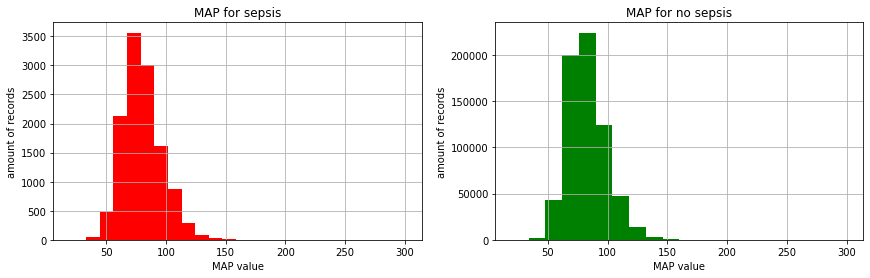

...

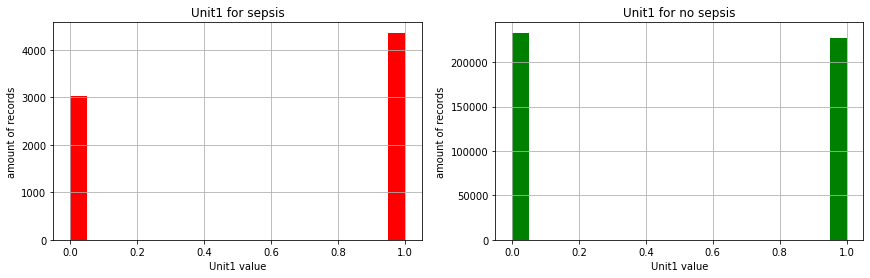

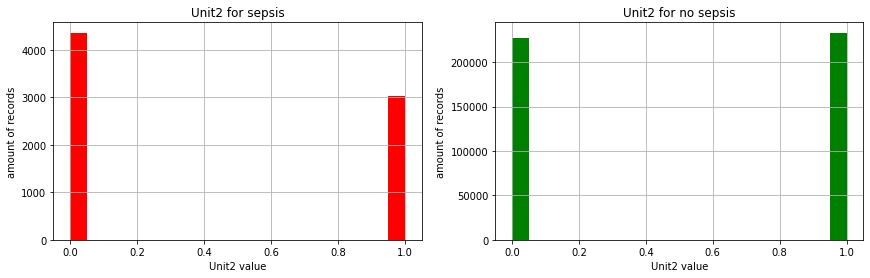

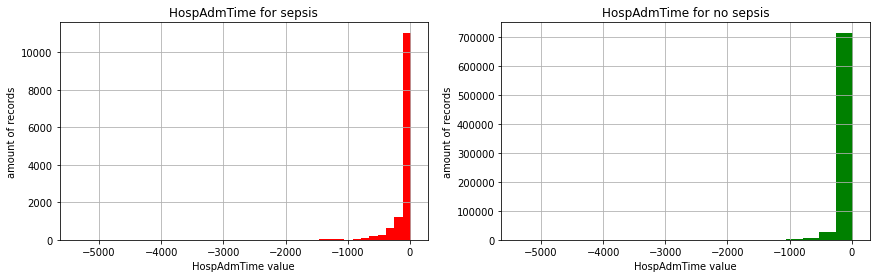

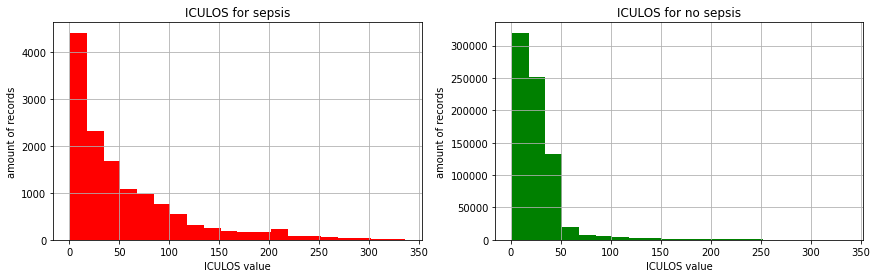

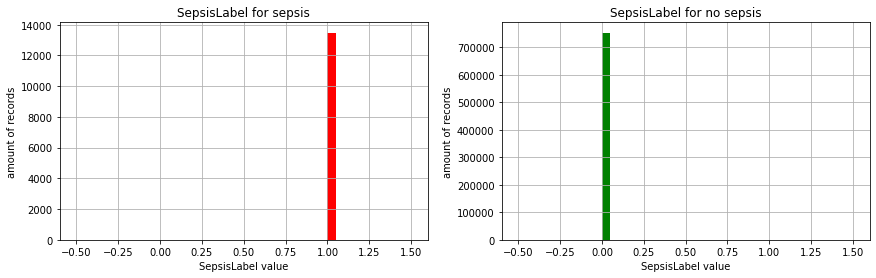

In [5]:
import matplotlib.pyplot as plt
feature_list = list(full_data.columns.values)
for feat in feature_list:
    fig=plt.figure()
    ax1 = plt.subplot(121)
    sepsis_data[feat].hist(color='r', bins=20)
    plt.title(feat+' for sepsis')
    plt.xlabel(feat+' value')
    plt.ylabel("amount of records")
    
    
    ax2 = plt.subplot(122, sharex = ax1)
    plt.subplot(1, 2, 2)
    non_sepsis_data[feat].hist(color='g', bins=20)
    plt.title(feat+' for no sepsis')
    plt.xlabel(feat+' value')
    plt.ylabel("amount of records")
    
    plt.subplots_adjust(right=2)
    plt.show()

missing data for each feature

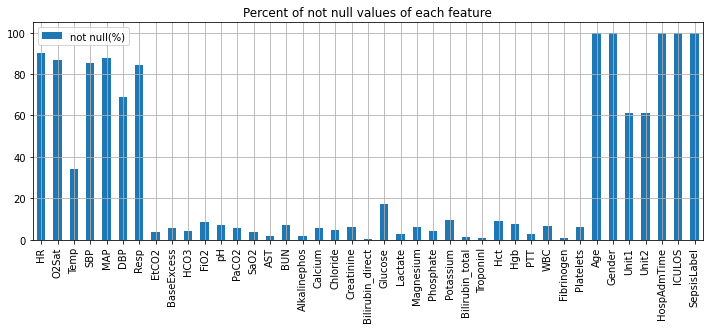

In [6]:
gr = description.plot.bar(y='not null(%)',figsize=(12, 4), grid=True, title='Percent of not null values of each feature')

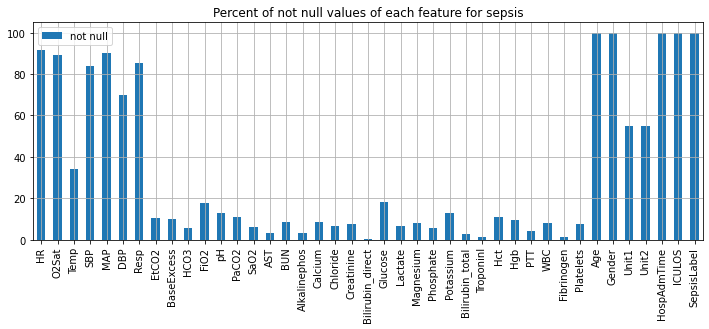

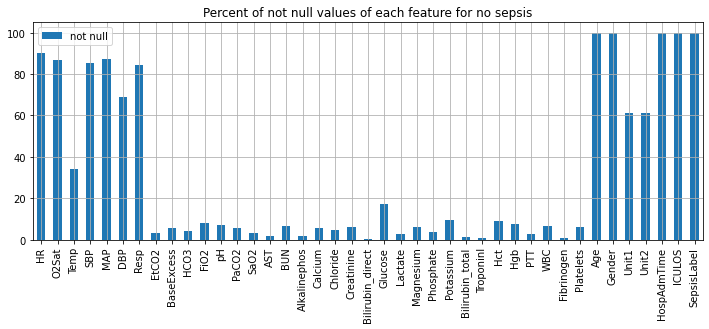

In [7]:
for tempdat, label in [(sepsis_data, "sepsis"), (non_sepsis_data, "no sepsis")]:
    temp_describe = tempdat.describe(include="all")
    temp_describe.loc['not null'] = round(temp_describe.loc['count'] / (tempdat.shape[0])*100,2)
    temp_describe.T.plot.bar(y='not null', figsize=(12, 4), grid=True, title='Percent of not null values of each feature for '+label)

## data analisys over cleaned data:

functions for data cleaning:

In [8]:
# returns "num_rows" window for the patient records and thier sepsis label
# for sepsis label 0 returns the last rows
# for sepsis label 1 returns the first row with sepsis label 1 and "num_rows-1" rows above it.


def take_rows(patient_df: pd.DataFrame, num_rows=25):
    if patient_df.SepsisLabel.sum()>0:
            last_row = patient_df.SepsisLabel.argmax()+1
            label = 1
    else:
        last_row = patient_df.shape[0]
        label = 0
    return patient_df.iloc[last_row-num_rows:last_row], label

In [9]:
# create dataframes for each feature/metric group, and in each of them every patient will be represented as one row
# patient row - is a result of an aggrigation of his "window" by metric(mean/std/max/min/last-mean-difference)

mean_df = pd.DataFrame(columns = full_data.columns)
std_df = pd.DataFrame(columns = full_data.columns)
max_df = pd.DataFrame(columns = full_data.columns)
min_df = pd.DataFrame(columns = full_data.columns)


for file_p in files:
    patient_df = pd.read_csv(f'data/train/{file_p}',sep='|')
    window_df, label = take_rows(patient_df)

    patient_mean = window_df.mean()
    patient_mean.SepsisLabel = label
    mean_df = mean_df.append(patient_mean, ignore_index = True)

    # std
    patient_std = window_df.std()
    patient_std.SepsisLabel = label
    std_df = std_df.append(patient_std, ignore_index = True)

    # max
    patient_max = window_df.max()
    patient_max.SepsisLabel = label
    max_df = max_df.append(patient_max, ignore_index = True)

    # min
    patient_min = window_df.max()
    patient_min.SepsisLabel = label
    min_df = min_df.append(patient_min, ignore_index = True)

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_df.append(patient_max, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_d

C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  min_df = min_df.append(patient_min, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  mean_df = mean_df.append(patient_mean, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  std_df = std_df.append(patient_std, ignore_index = True)
C:\Users\m4or6\AppData\Local\Temp/ipykernel_23740/1067437811.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  max_df = max_d

In [12]:
# make Ttest for current parameter in current dataframe, where:
# μ1 is the μ for "have sepsis"
# μ2 is the μ for "no sepsis"
# null hypothesis H0: μ1 = μ2
# returns the p_value for the Ttest.

from scipy import stats

def t_test(feature, temp_df):
    # t-test for null hypothesis H0 that μ1 = μ2
    sepsis=temp_df[temp_df['SepsisLabel']==1][feature].dropna()  # for μ1
    non_sepsis=temp_df[temp_df['SepsisLabel']==0][feature].dropna()  # for μ2

    t_value,p_value=stats.ttest_ind(sepsis,non_sepsis)
    
    return p_value

In [19]:

feature_list = list(full_data.columns)
# remove the features that are always the same and the target feature (Sepsis label)
feature_list = [x for x in feature_list if x not in ['Unit1','Unit2','HospAdmTime','ICULOS','SepsisLabel']]

alpha = 0.05 / (4*len(feature_list))

p_values = []
test_labels = []
significant_features = []

for df, metric in [(mean_df, "mean"), (std_df, "std"), (max_df, "max"), (min_df, "min")]:
    for feature in feature_list:
        p_value = t_test(feature, df)
        if p_value <= alpha:
            significant_features += [(metric, feature)]
            print(f"The difference of {feature} under {metric} metric between sepsis and no sepsis is statisticaly significant")
            print(f"with p_value {p_value}")
            print()
        p_values += [p_value]
        test_labels += [(metric, feature)]

The difference of HR under mean metric between sepsis and no sepsis is statisticaly significant
with p_value 6.26296242309339e-35

The difference of Temp under mean metric between sepsis and no sepsis is statisticaly significant
with p_value 8.373827432466318e-25

The difference of MAP under mean metric between sepsis and no sepsis is statisticaly significant
with p_value 2.3070023616731012e-05

The difference of DBP under mean metric between sepsis and no sepsis is statisticaly significant
with p_value 1.4551207375716744e-05

The difference of Resp under mean metric between sepsis and no sepsis is statisticaly significant
with p_value 1.450232275270444e-28

The difference of FiO2 under mean metric between sepsis and no sepsis is statisticaly significant
with p_value 1.7669052912286009e-06

The difference of BUN under mean metric between sepsis and no sepsis is statisticaly significant
with p_value 8.220010648359289e-16

The difference of Calcium under mean metric between sepsis and no

In [20]:
print("The significant features are:")
print(set(significant_features))

The significant features are:
{('max', 'HR'), ('min', 'Calcium'), ('max', 'Calcium'), ('mean', 'Temp'), ('mean', 'FiO2'), ('mean', 'Glucose'), ('mean', 'Resp'), ('min', 'BUN'), ('std', 'Calcium'), ('max', 'BUN'), ('min', 'WBC'), ('max', 'WBC'), ('mean', 'HR'), ('min', 'Hgb'), ('max', 'Hgb'), ('mean', 'Calcium'), ('min', 'Hct'), ('max', 'Hct'), ('mean', 'BUN'), ('std', 'SBP'), ('min', 'Temp'), ('max', 'Temp'), ('mean', 'Hgb'), ('mean', 'WBC'), ('mean', 'MAP'), ('mean', 'Hct'), ('min', 'Resp'), ('max', 'Resp'), ('mean', 'DBP'), ('std', 'Temp'), ('min', 'HR')}


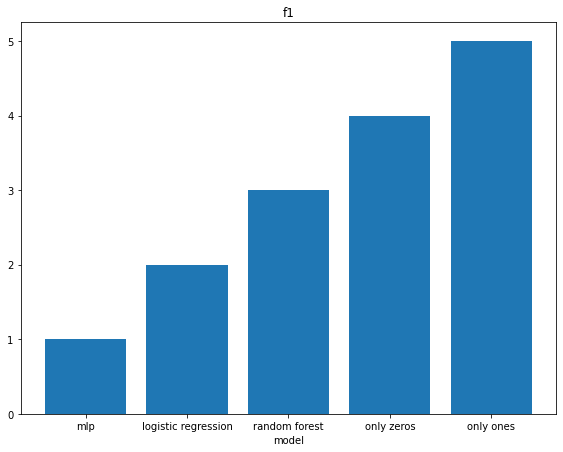

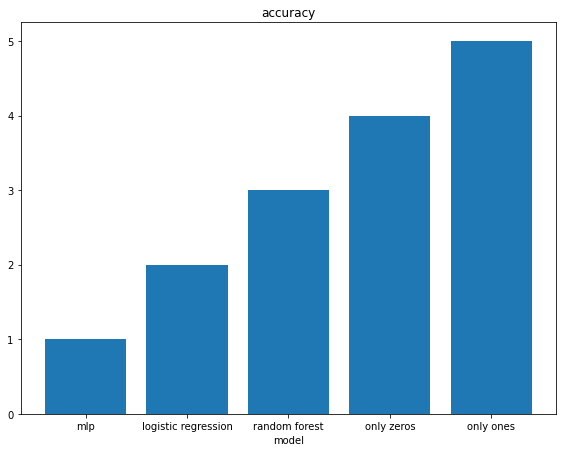

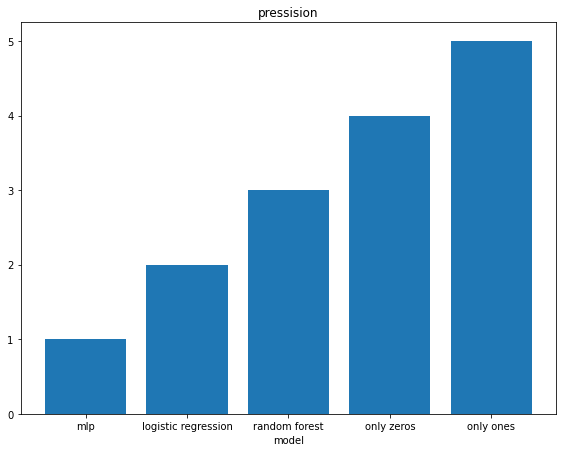

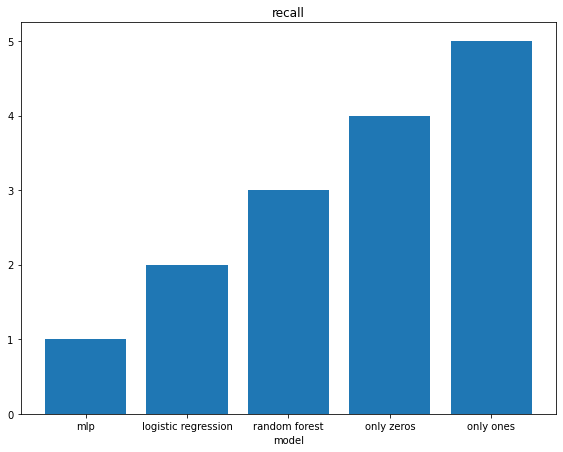

In [28]:
f1 = [1,2,3,4,5]
accuracy = [1,2,3,4,5]
pressision = [1,2,3,4,5]
recall = [1,2,3,4,5]
models = ["mlp", "logistic regression", "random forest", "only zeros", "only ones"]
plt.rcParams["figure.figsize"] = (6.4*1.5, 4.8*1.5) 
for y, label in [(f1,"f1"), (accuracy,"accuracy"), (pressision, "pressision"), (recall, "recall")]:
    plt.bar(models, y, width=0.8)
    plt.xlabel("model")
    plt.title(label)
    plt.show()